In [ ]:
# ETHAN COLE
# Please feel free to adapt and work on this, just copy to a different directory.

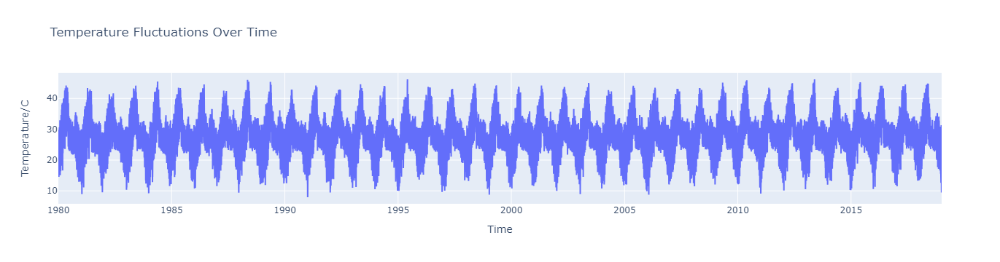

In [46]:
#Above we have a dataset that is in Kelvin, we need to subtract 273.15 from each temperature value in order to get it into Celsius.
import plotly.graph_objects as go
import pandas as pd

# Define column names
columns = ['year', 'month', 'day', 'hour', 'temperature', 'precipitation', 'u-wind', 'v-wind']

# Load data from CSV without headers
data = pd.read_csv("17.36N_78.5E.csv", names=columns)
data['temperature'] -= 273.15

# Extract timestamps and temperature values
timestamps = pd.to_datetime(data[['year', 'month', 'day', 'hour']])
temperature = data['temperature']
# Create plotly figure
fig = go.Figure()
# Add temperature trace
fig.add_trace(go.Scatter(x=timestamps, y=temperature, mode='lines', name='Temperature'))
# Update layout
fig.update_layout(title='Temperature Fluctuations Over Time',
                   xaxis_title='Time',
                   yaxis_title='Temperature/C')

# Show plot
fig.show()


In [70]:
#So I want to use scikit learn's MLP regressor model to predict temperature 
import pandas as pd
from IPython.display import display
# Define column names
columns = ['year', 'month', 'day', 'hour', 'temperature', 'precipitation', 'u-wind', 'v-wind']

# Load data from CSV without headers
df = pd.read_csv("17.36N_78.5E.csv", names=columns) #Here we are only choosing one of the CSV files, 
                                                            #this can be expanded to make use of the full data set
df['temperature'] -= 273.15
#Now I have the dataset loaded and the temperature adjusted to celcius
df

,year,month,day,hour,temperature,precipitation,u-wind,v-wind
0,1980,1,1,0,17.59,0.0,-0.063355,2.81810
1,1980,1,1,1,17.69,0.0,0.038482,2.43180
2,1980,1,1,2,18.79,0.0,0.538340,2.22210
3,1980,1,1,3,23.40,0.0,1.049000,2.27480
4,1980,1,1,4,24.29,0.0,1.115400,2.75550
...,...,...,...,...,...,...,...,...
341875,2018,12,31,19,17.60,0.0,-1.388800,0.93791
341876,2018,12,31,20,17.70,0.0,-0.838810,0.99260
341877,2018,12,31,21,17.43,0.0,-0.669240,0.78582
341878,2018,12,31,22,15.64,0.0,-0.513420,0.40313


In [71]:
#This cell just trims the entire dataframe down to make testing faster, here we take the first 20% of the rows...
import numpy as np
percentage = 0.4  # Top 10% of dataframe rows...
df_top = df[(df.index > np.percentile(df.index, 100-(percentage*10)))]
num_rows = len(df)
top_rows = int(num_rows * percentage)
df_top = df.head(top_rows)
df = df_top
df

,year,month,day,hour,temperature,precipitation,u-wind,v-wind
0,1980,1,1,0,17.59,0.000000e+00,-0.063355,2.818100
1,1980,1,1,1,17.69,0.000000e+00,0.038482,2.431800
2,1980,1,1,2,18.79,0.000000e+00,0.538340,2.222100
3,1980,1,1,3,23.40,0.000000e+00,1.049000,2.274800
4,1980,1,1,4,24.29,0.000000e+00,1.115400,2.755500
...,...,...,...,...,...,...,...,...
136747,1995,8,7,19,25.95,-3.682800e-09,3.353300,0.781060
136748,1995,8,7,20,25.95,1.567500e-05,3.943900,0.331720
136749,1995,8,7,21,25.78,8.817400e-06,4.220700,0.122140
136750,1995,8,7,22,25.20,-3.725300e-09,4.439900,0.021541


In [72]:
import pandas as pd
#This cell produces new one-hot encoded values from the date columns, classifying them as seasons, times of day
#We also make the day of week cyclic, classifying them to monday,tuesday,wednesday... as numbers 0-6

print(df['hour'].unique())
# Assuming df is your dataframe
df['datetime'] = pd.to_datetime(df[['year', 'month', 'day', 'hour']])
df['season'] = df['datetime'].dt.month // 3 + 1  # Divide months into seasons
df['time_of_day'] = pd.cut(df['hour'], bins=[-1, 6, 12, 18, 24], labels=[0, 1, 2, 3]) # 0,1,2,3 represent night,morning,afternoon,evening
df['day_of_week'] = df['datetime'].dt.day_of_week
df['time_since_start'] = (df['datetime'] - df['datetime'].min()).dt.days
df.drop(columns=['datetime'], inplace=True)


[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]


C:\Users\ethan\AppData\Local\Temp\ipykernel_21572\2577349947.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ethan\AppData\Local\Temp\ipykernel_21572\2577349947.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ethan\AppData\Local\Temp\ipykernel_21572\2577349947.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

In [ ]:
#Optionally perform PCA dimensionality reduction or other preprocessing here...

In [73]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split
# Split data into train and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(
    df.drop(columns=['temperature']),  # Features (X)
    df['temperature'],  # Target variable (y)
    test_size=0.2,  # 20% for test set
    random_state=1  # For reproducibility
)

# Further split the train set into train and validation sets (60% train, 20% validation)
X_train, X_val, y_train, y_val = train_test_split(
    X_train, y_train,
    test_size=0.25,  # 20% for validation set (0.25 * 0.8 = 0.2)
    random_state=1  # For reproducibility
)

# Now you have X_train, y_train (for training),
# X_val, y_val (for validation), and
# X_test, y_test (for testing)
display(X_train) # X_train contains our data values excluding temperature
display(y_train) # y_train is our target variable dataframe

,year,month,day,hour,precipitation,u-wind,v-wind,season,time_of_day,day_of_week,time_since_start
27026,1983,1,31,2,3.725300e-09,1.24820,-0.64965,1,0,0,1126
26616,1983,1,14,0,3.725300e-09,-1.34810,-1.45440,1,0,4,1109
104514,1991,12,3,18,0.000000e+00,-2.11360,0.62170,5,2,1,4354
95525,1990,11,24,5,1.712500e-06,-2.09100,-0.96733,4,0,5,3980
30971,1983,7,14,11,1.260500e-03,-1.66330,-0.39320,3,1,3,1290
...,...,...,...,...,...,...,...,...,...,...,...
8209,1980,12,8,1,0.000000e+00,-0.28100,-2.13070,5,0,0,342
69806,1987,12,18,14,-1.862600e-09,-2.03260,-1.98100,5,2,4,2908
33415,1983,10,24,7,3.725300e-09,-1.67140,-2.44240,4,1,0,1392
13921,1981,8,3,1,1.681700e-05,4.31310,-0.76870,3,0,0,580


27026     18.08
26616     13.66
104514    20.39
95525     26.62
30971     31.73
          ...  
8209      14.28
69806     18.19
33415     29.34
13921     24.38
99403     32.58
Name: temperature, Length: 82050, dtype: float64

In [74]:
#Check for not a number values:
nan_values = df.isna()
print(nan_values.sum())
display(df['time_of_day'])
nan_values = df['time_of_day'].isna()
print(nan_values)
display(df['time_of_day'].unique())

year                0
month               0
day                 0
hour                0
temperature         0
precipitation       0
u-wind              0
v-wind              0
season              0
time_of_day         0
day_of_week         0
time_since_start    0
dtype: int64


0         0
1         0
2         0
3         0
4         0
         ..
136747    3
136748    3
136749    3
136750    3
136751    3
Name: time_of_day, Length: 136752, dtype: category
Categories (4, int64): [0 < 1 < 2 < 3]

0         False
1         False
2         False
3         False
4         False
          ...  
136747    False
136748    False
136749    False
136750    False
136751    False
Name: time_of_day, Length: 136752, dtype: bool


[0, 1, 2, 3]
Categories (4, int64): [0 < 1 < 2 < 3]

In [75]:
# Create an MLPRegressor with one hidden layer of 100 neurons
model = MLPRegressor(hidden_layer_sizes=(128, 64, 32, 16), activation='relu', solver='adam', max_iter=250, verbose=True)

# Fit the model to your training data
model.fit(X_train, y_train)


Iteration 1, loss = 64.88181359
Iteration 2, loss = 16.08556161
Iteration 3, loss = 15.53724722
Iteration 4, loss = 15.23706562
Iteration 5, loss = 15.04981898
Iteration 6, loss = 15.57915752
Iteration 7, loss = 14.90232018
Iteration 8, loss = 14.73404998
Iteration 9, loss = 14.95479912
Iteration 10, loss = 14.51896579
Iteration 11, loss = 14.51294734
Iteration 12, loss = 14.58004890
Iteration 13, loss = 14.29795722
Iteration 14, loss = 14.17808290
Iteration 15, loss = 13.95259906
Iteration 16, loss = 13.92501604
Iteration 17, loss = 13.88485756
Iteration 18, loss = 13.85202143
Iteration 19, loss = 13.71742681
Iteration 20, loss = 13.86138089
Iteration 21, loss = 13.46472929
Iteration 22, loss = 13.33808133
Iteration 23, loss = 13.40701068
Iteration 24, loss = 13.34738982
Iteration 25, loss = 13.12053219
Iteration 26, loss = 13.05602848
Iteration 27, loss = 12.91766499
Iteration 28, loss = 12.83405722
Iteration 29, loss = 12.92716475
Iteration 30, loss = 12.69932073
Iteration 31, loss 

MLPRegressor(hidden_layer_sizes=(128, 64, 32, 16), max_iter=250, verbose=True)

In [76]:
#Predicting values over my test set...
y_pred = model.predict(X_test)

In [82]:
from sklearn.metrics import mean_squared_error

mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse:.2f}")


Mean Squared Error: 4.47


In [80]:
df_results = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred, 'Residuals':(abs(y_test-y_pred))})
display(df_results.head())
print()
from sklearn.metrics import r2_score
score = r2_score(y_test, y_pred)
print("The accuracy of our model is {}%".format(round(score, 5) *100))

,Actual,Predicted,Residuals
73949,37.71,30.581148,7.128852
32534,25.17,26.721965,1.551965
111452,23.14,24.187116,1.047116
26846,23.62,24.345574,0.725574
61615,23.48,24.749946,1.269946



The accuracy of our model is 86.923%


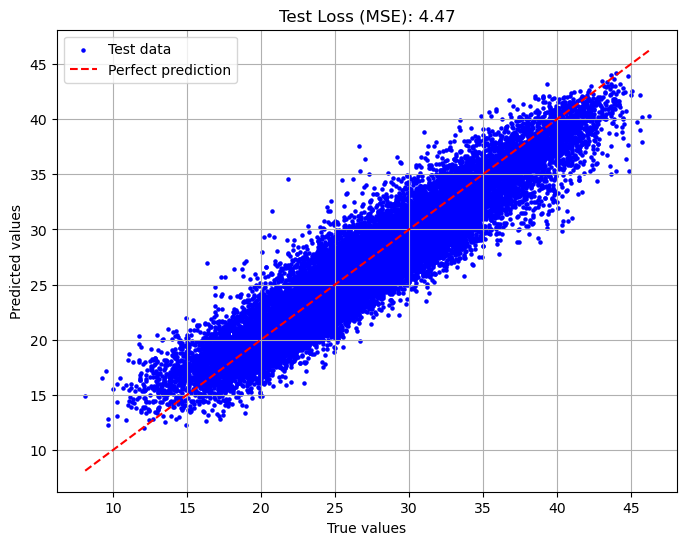

In [81]:
import matplotlib.pyplot as plt
test_loss = mean_squared_error(y_test, y_pred)

# Plot test loss
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, color='blue', label='Test data', s = 5)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Perfect prediction')
plt.title('Test Loss (MSE): {:.2f}'.format(test_loss))
plt.xlabel('True values')
plt.ylabel('Predicted values')
plt.legend()
plt.grid(True)
plt.show()